# StyleGAN-NADA re-implementation

Данная работа является реимплементацией [StyleGAN-NADA](https://stylegan-nada.github.io/).

В чем заключается работа?
Представим, мы имеем уже обученный [StyleGAN2](https://github.com/rosinality/stylegan2-pytorch), который генерирует картинки, например, человеческие лица. Теперь мы хотим изменить генерацию так, чтобы теперь лица генерировались, скажем, в **аниме** стиле.
Для того, чтобы реализовать эту задачу, воспользуемся моделью [CLIP](https://paperswithcode.com/method/clip), чтобы она "направляла" генерацию из стиля *A* в стиль *Б*. 

Пайплайн построен следующим образом.

- Инициализация обучаемой и "замороженной" моделей StyleGAN2

- Реализация лоссов(CLIPLoss, IDLoss, MSELoss)

- Создание текстовой пары *A* и *B* для CLIP

- Обучение генератора

- Финальное сравнение обученного и замороженного StyleGAN2


Приступим!

## Установка необходимых библиотек и подготовка окружения
Начнем с установки необходимых библиотек и репозиториев CLIP и StyleGAN2

In [ ]:
# Установка необходимых библиотек

# Установка зависимостей
!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git
# Установка дополнительных библиотек
!pip install Ninja

# Импорт нужных библиотек
import os

import torch
import torch.nn as nn
import torch.optim as optim

from torchvision import transforms
from torchvision.utils import save_image

import clip

from PIL import Image

import numpy as np

import matplotlib.pyplot as plt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.1 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-yatawlcv
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-yatawlcv
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Клонирование репозитория StyleGAN2
!git clone https://github.com/rosinality/stylegan2-pytorch.git

Cloning into 'stylegan2-pytorch'...
remote: Enumerating objects: 395, done.
remote: Total 395 (delta 0), reused 0 (delta 0), pack-reused 395 (from 1)
Receiving objects: 100% (395/395), 122.51 MiB | 47.94 MiB/s, done.
Resolving deltas: 100% (203/203), done.


In [ ]:
cd stylegan2-pytorch/

/kaggle/working/stylegan2-pytorch


In [ ]:
# Будем работать с конкретным сидом
torch.manual_seed(345)

In [ ]:
# Зададим девайс: cuda или cpu
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Зададим сид
seed = 3456
torch.manual_seed(seed)

## Основная идея статьи


Как уже было сказано, мы хотим перенести изображение из стилевого пространства *A* в пространство *Б*. Для этого будем использовать [CLIP](https://paperswithcode.com/method/clip) модель для некоторого гайданса в процессе оптимизации.

Задачу мы хотим построить следующим образом: мы хотим оптимизировать веса StyleGAN2 под текстовый запрос $t'$, предполагая, что генерация исходной модели соответствует описанию $t$.

Для работы со StyleGAN-2 нам для начала нужно скачать модель. Для скачивания мы используем следующий код:

In [ ]:
!pip install google.colab
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# downloads StyleGAN's weights and facial recognition network weights
ids = ['1EM87UquaoQmk17Q8d5kYIAHqu0dkYqdT', '1N0MZSqPRJpLfP4mFQCS14ikrVSe8vQlL']
for file_id in ids:
  downloaded = drive.CreateFile({'id':file_id})
  downloaded.FetchMetadata(fetch_all=True)
  downloaded.GetContentFile(downloaded.metadata['title'])

## Задача оптимизации

Теперь давайте подронее сформулируем задачу оптимизации.

Нам необходимо следующее:

- Отредактированное изображение соответствует текстовому запросу

- Сохраняет identity изначального человека.

Авторы предлагают следующий лосс для оптимизации:

$$\arg \min_{w \in W} D_{\text{CLIP}}(G(w), t) + \lambda_2 \|w - w_s\|_2 + \lambda_{\text{ID}} L_{\text{ID}}(w)
$$

Давайте разберёмся с каждой частью подробнее.

### CLIP loss

Начнём мы с CLIP loss.

 $D_{\text{CLIP}}$ — косинусное расстояние между эмбеддингами [CLIP](https://habr.com/ru/articles/539312/) для двух аргументов.

$$D_{\text{CLIP}}(G(w), t) = 1 - \frac{\langle E_{\text{CLIP}}(G(w)) \cdot E_{\text{CLIP}}(t) \rangle }{\|E_{\text{CLIP}}(G(w))\| \cdot \|E_{\text{CLIP}}(t)\|}$$


Реализацию CLIP Loss можно найти в файле losses.py

In [ ]:
from losses import CLIPLoss

clip_loss = CLIPLoss()

### ID loss

Для сохранения identity человека использует специально предобученную модель [ArcFace](https://arxiv.org/abs/1801.07698), которая по фотографии вычисляет некоторые характерные для человека embedding вектора. Затем нам необходимо посчитать косинусное расстояние между ожидаемым embedding вектором и тем, что получается в процессе оптимизации:

$$ L_{\text{ID}}(w) = 1 - \langle R(G(w_s)), R(G(w)) \rangle $$

Обратите внимание, что здесь не используется дополнительная нормировка


Давайте подгрузим нашу модель и реализуем желаемую функцию потерь.


### Подгрузка модели

Далее у нас будет подгрузка самой модели, позаимствованная из репозитория [StyleCLIP](https://github.com/orpatashnik/StyleCLIP/blob/main/models/facial_recognition/helpers.py). Вы можете более подробно ознакомиться с кодом этой модели ниже, но не будем заострять на ней внимание.


### ID loss

Теперь непосредственно реализуем нашу функцию потерь.

In [ ]:
from losses import IDLoss

In [ ]:
# Загрузим нашу модель ArcFace
model_path = "./stylegan2-pytorch/model_ir_se50.pth"
id_loss = IDLoss(model_path, device)

Loading ResNet ArcFace


## Оптимизация для редактирования изображения
Реализуем оптимизацию, используя Adam.

Полная функция потерь считается по формуле:
$$\arg \min_{w \in W} D_{\text{CLIP}}(G(w), t) + \lambda_2 \|w - w_s\|_2 + \lambda_{\text{ID}} L_{\text{ID}}(w)
$$

In [ ]:
# Подготовим папку для сохранения результатов
import os
save_dir = "results"
os.makedirs(save_dir, exist_ok=True)

In [ ]:
%matplotlib inline

In [ ]:
def visual_compare(filtered, target):
    fig, axs = plt.subplots(1, 2, figsize=(16, 32))  # Создание подграфиков для визуализации
    # Визуализация сгенерированного изображения
    axs[1].imshow((filtered.cpu().detach()[0].clip(-1,1).permute(1, 2, 0) + 1) / 2)
    axs[1].set_title("Обработанное изображение (Стиль Б)")  # Заголовок для обработанного изображения
    axs[1].axis('off')  # Отключение осей

    # Визуализация целевого изображения
    axs[0].imshow((target.cpu().detach()[0].clip(-1,1).permute(1, 2, 0) + 1) / 2)
    axs[0].set_title("Исходное изображение (Стиль А)")  # Заголовок для исходного изображения
    axs[0].axis('off')  # Отключение осей
    plt.show()

In [ ]:
# Загрузка модели генератора StyleGAN2
from model import Generator
latent_dim = 512
generator = Generator(size=1024, style_dim=latent_dim, n_mlp=8).to(device)
state_dict = torch.load('/kaggle/working/stylegan2-pytorch/stylegan2-ffhq-config-f.pt', map_location=device)
generator.load_state_dict(state_dict['g_ema'])
generator.eval()

print("Генератор StyleGAN2 загружены.")

Генератор StyleGAN2 загружены.


Загрузим второй генератор, чтобы сравнить генерацию обычного изображения с таргетом.

In [ ]:
generator_clean = Generator(size=1024, style_dim=latent_dim, n_mlp=8).to(device)
generator_clean.load_state_dict(state_dict['g_ema'])
generator_clean.eval()

Generator(
  (style): Sequential(
    (0): PixelNorm()
    (1): EqualLinear(512, 512)
    (2): EqualLinear(512, 512)
    (3): EqualLinear(512, 512)
    (4): EqualLinear(512, 512)
    (5): EqualLinear(512, 512)
    (6): EqualLinear(512, 512)
    (7): EqualLinear(512, 512)
    (8): EqualLinear(512, 512)
  )
  (input): ConstantInput()
  (conv1): StyledConv(
    (conv): ModulatedConv2d(512, 512, 3, upsample=False, downsample=False)
    (noise): NoiseInjection()
    (activate): FusedLeakyReLU()
  )
  (to_rgb1): ToRGB(
    (conv): ModulatedConv2d(512, 3, 1, upsample=False, downsample=False)
  )
  (convs): ModuleList(
    (0): StyledConv(
      (conv): ModulatedConv2d(512, 512, 3, upsample=True, downsample=False)
      (noise): NoiseInjection()
      (activate): FusedLeakyReLU()
    )
    (1): StyledConv(
      (conv): ModulatedConv2d(512, 512, 3, upsample=False, downsample=False)
      (noise): NoiseInjection()
      (activate): FusedLeakyReLU()
    )
    (2): StyledConv(
      (conv): Modul

## Инициализация текстовой пары
Определим текстовые запросы $t$ и $t'$ и преобразуем в вектор с помощью CLIP.

In [ ]:
# Подготавливаем текстовый промпт для оптимизации, который будет направлять изменение изображения.
source_text = "photo of a human" #@param {"type": "string"}
target_text = "Anime-style portrait, jojo style" #@param {"type": "string"}

# Токенизируем промпты с помощью CLIP tokenizer и перемещаем на устройство (CPU или GPU).
# clip.tokenize: функция из библиотеки CLIP для токенизации текста.
source_text_features = torch.cat([clip.tokenize(source_text)]).to(device)
target_text_features = torch.cat([clip.tokenize(target_text)]).to(device)

Step 0, Loss: 0.6298828125


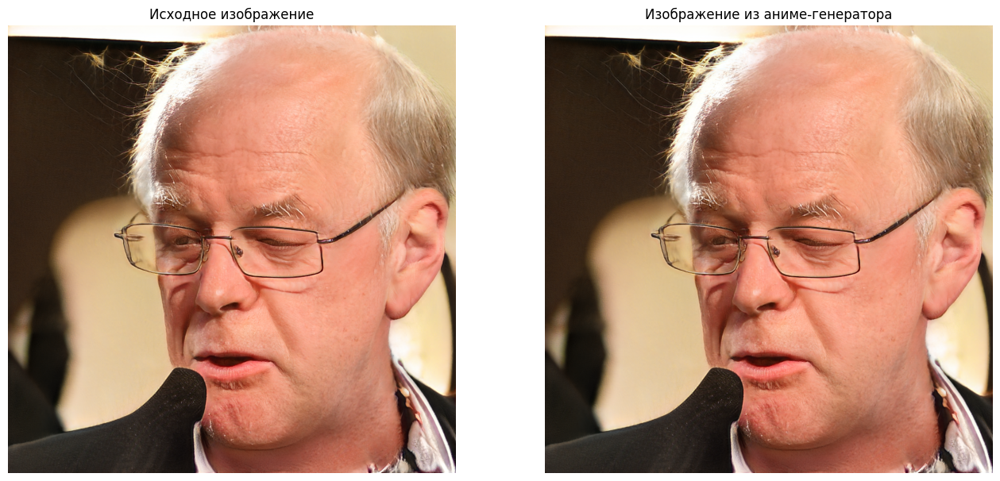

Step 50, Loss: 0.9884496927261353


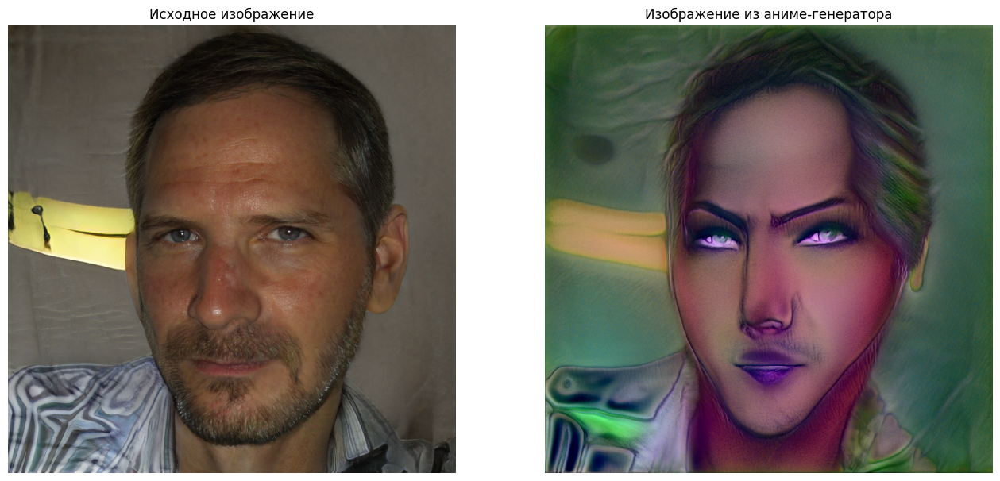

Step 100, Loss: 1.0564038753509521


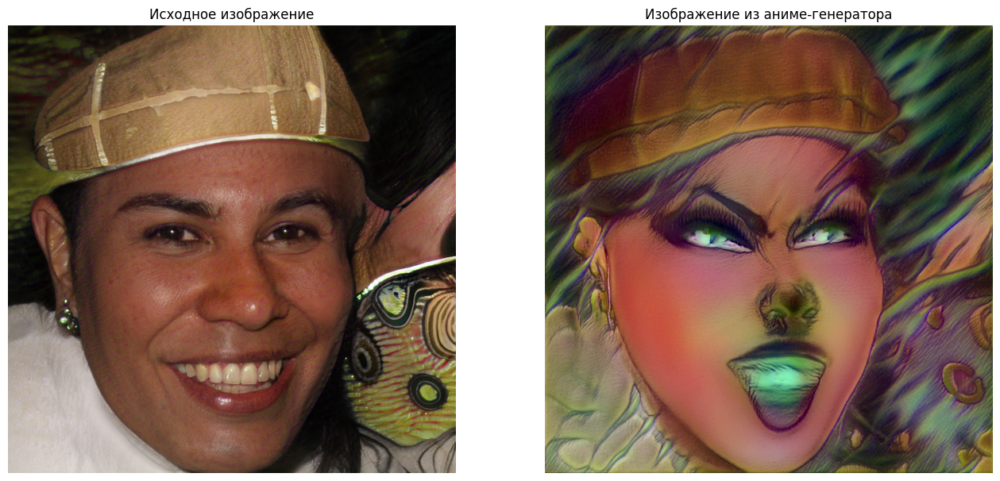

Step 150, Loss: 1.029435634613037


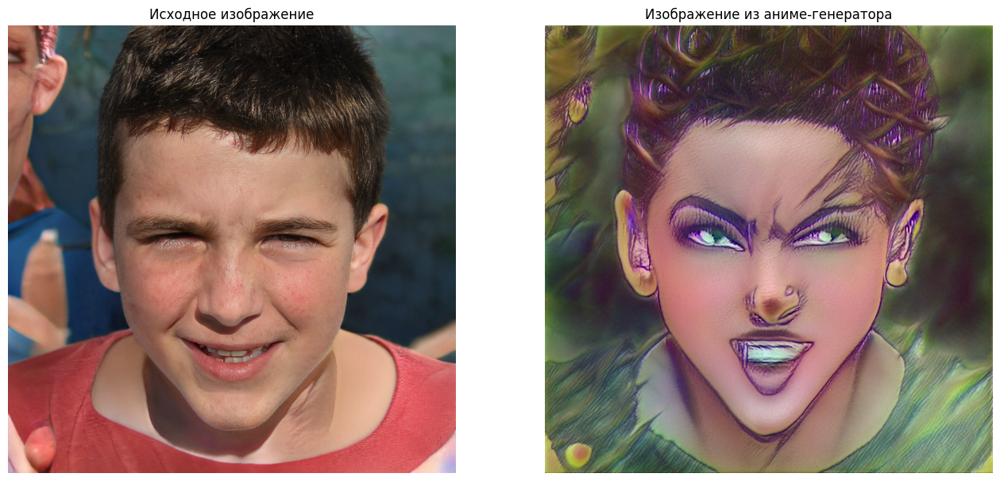

Step 200, Loss: 1.0134068727493286


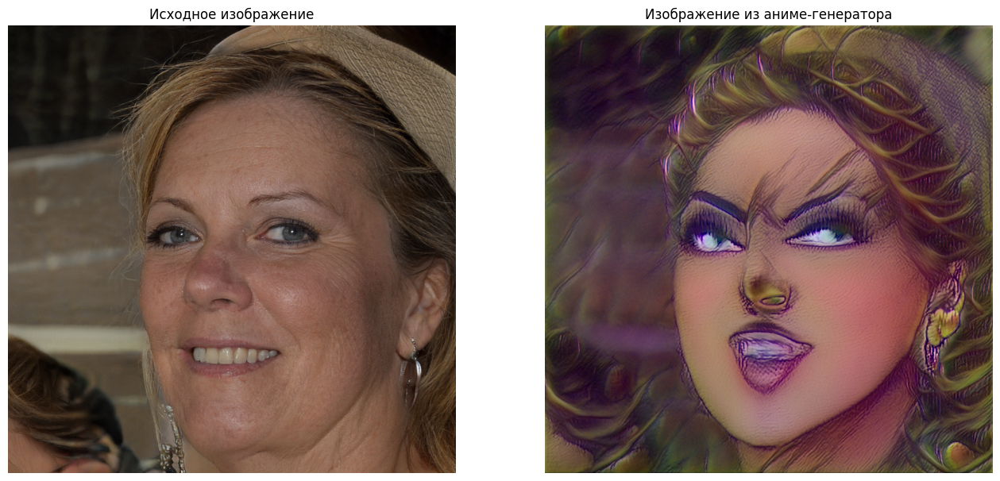

Step 250, Loss: 0.8749395608901978


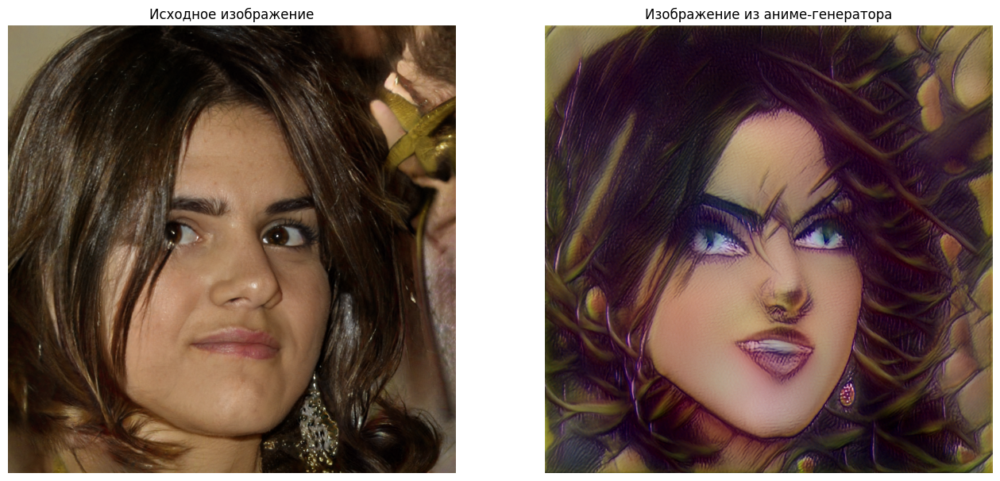

Step 300, Loss: 0.8907665014266968


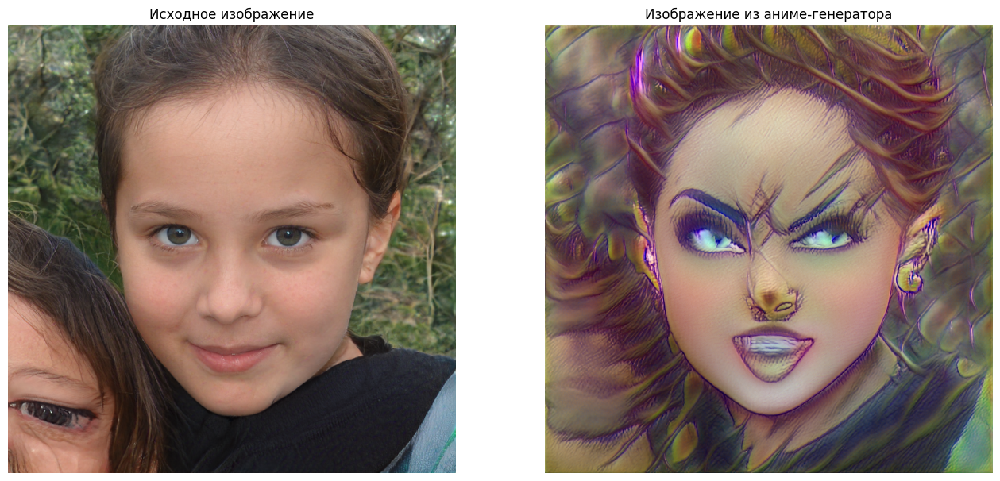

Step 350, Loss: 0.9569770693778992


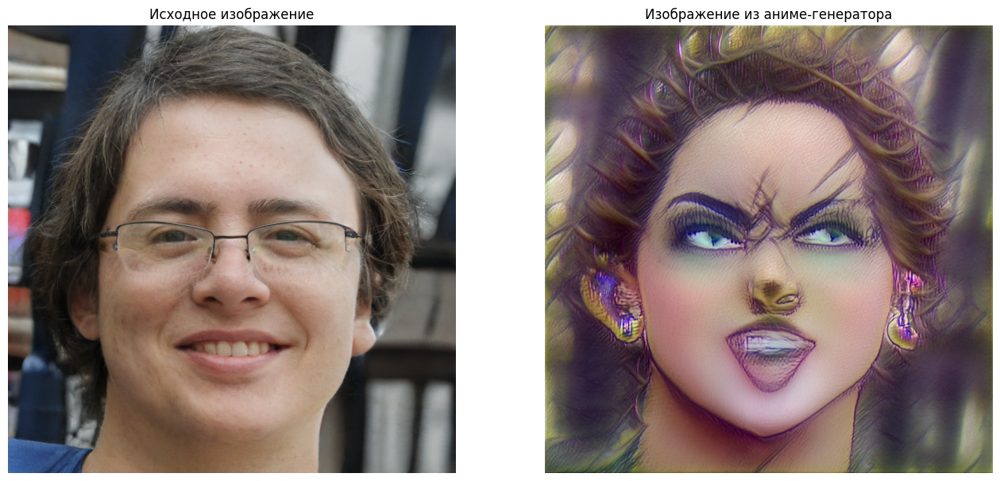

Step 400, Loss: 0.9364343881607056


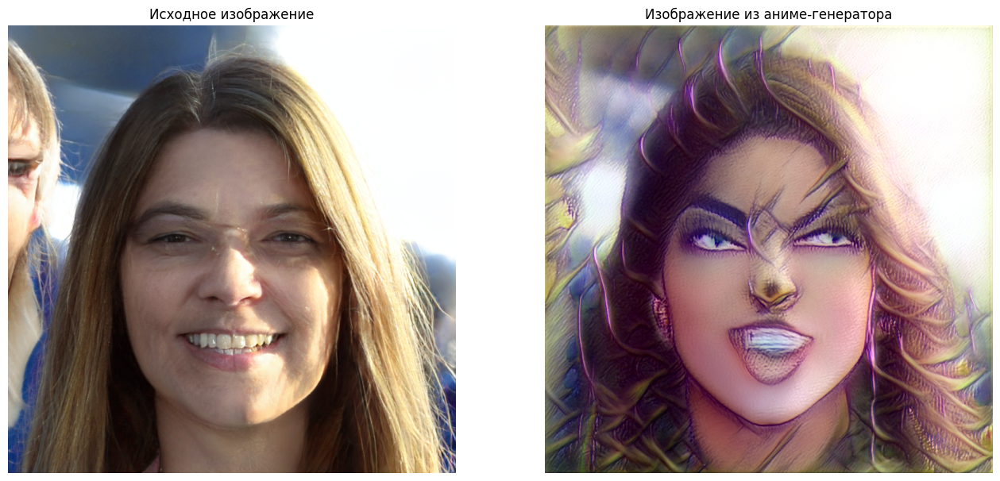

Step 450, Loss: 0.8711746335029602


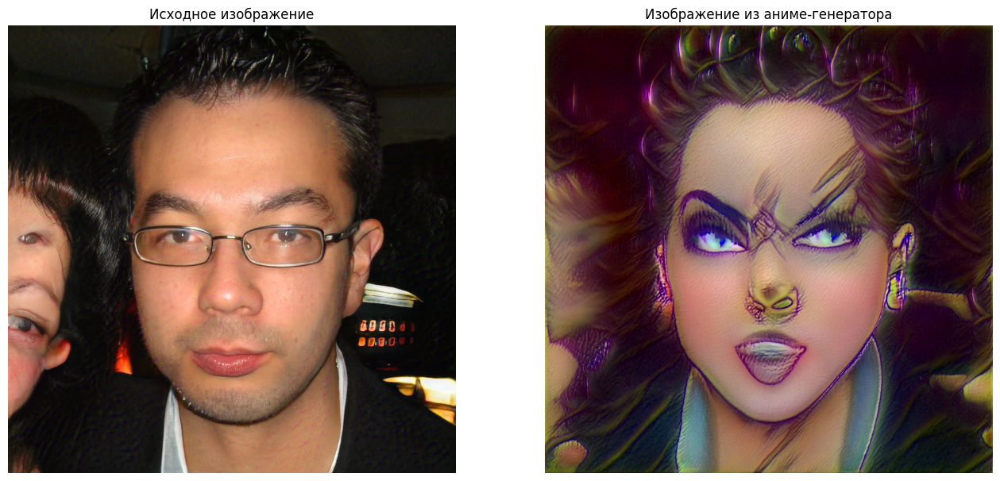

Step 500, Loss: 0.8333983421325684


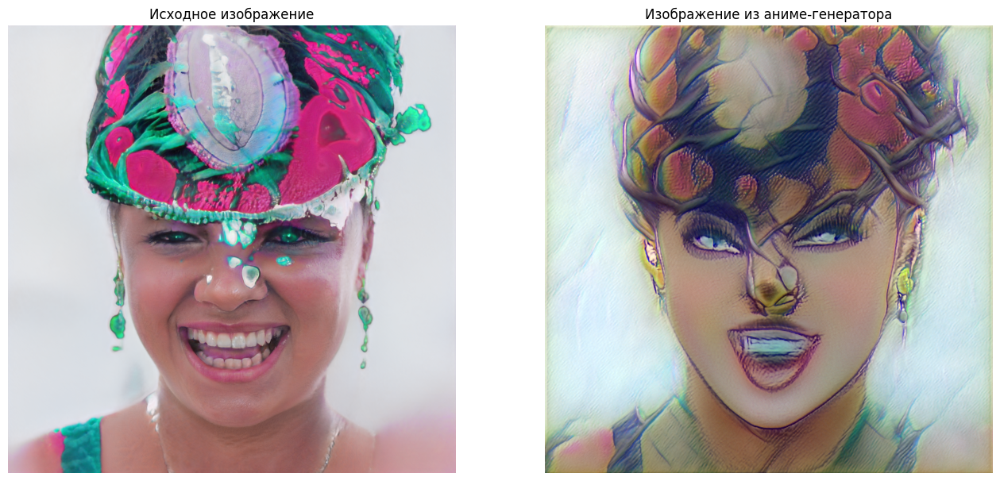

Step 550, Loss: 0.9050383567810059


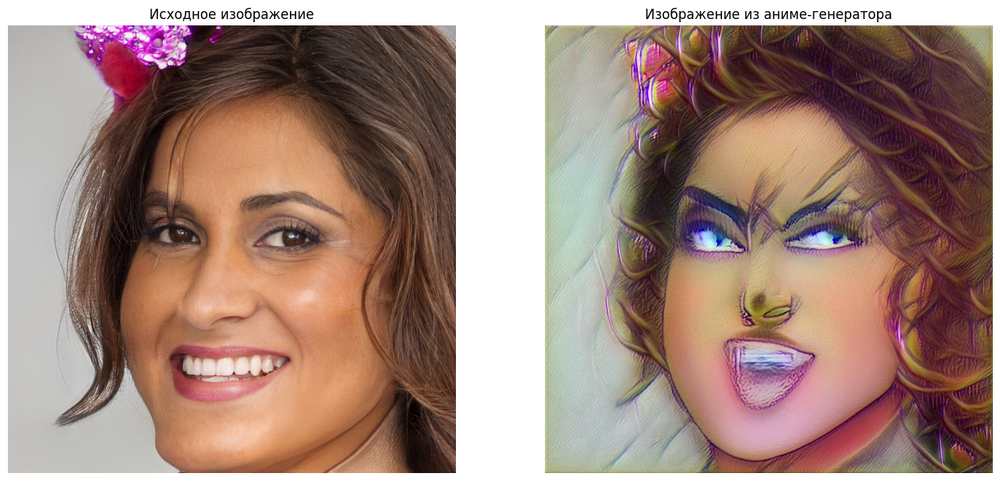

Step 600, Loss: 0.8617638945579529


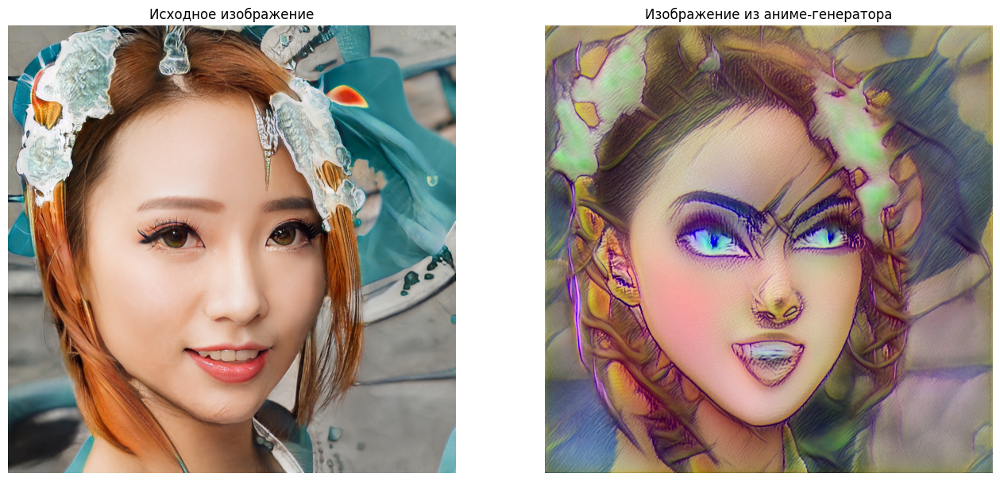

Step 650, Loss: 0.909601092338562


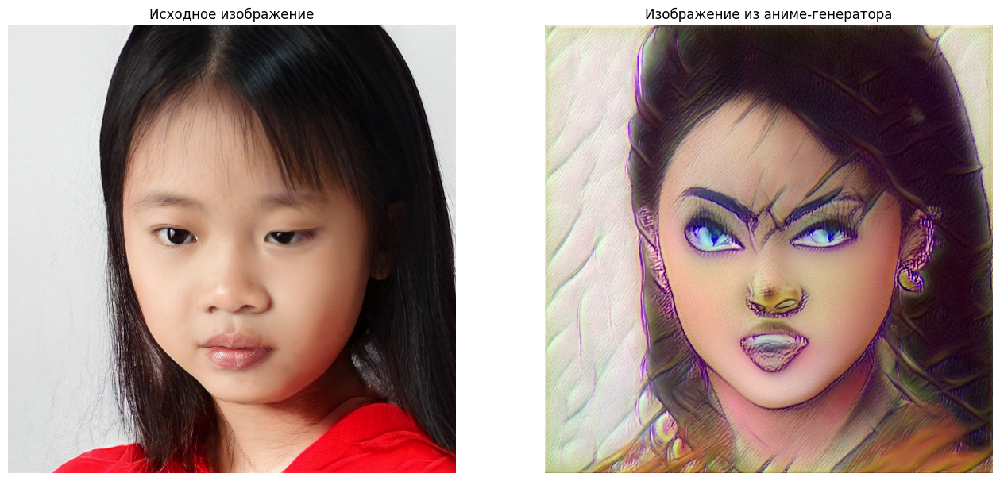

Step 700, Loss: 0.9182901978492737


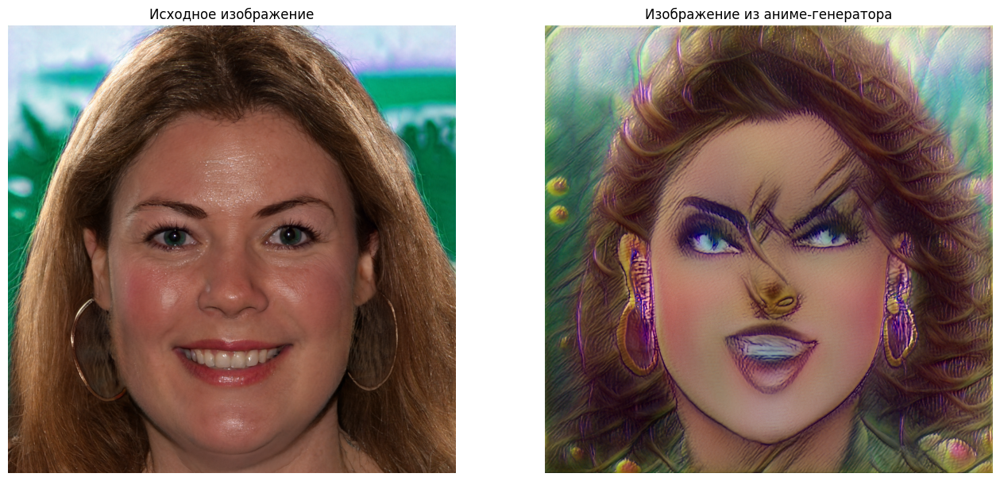

Step 750, Loss: 0.9226021766662598


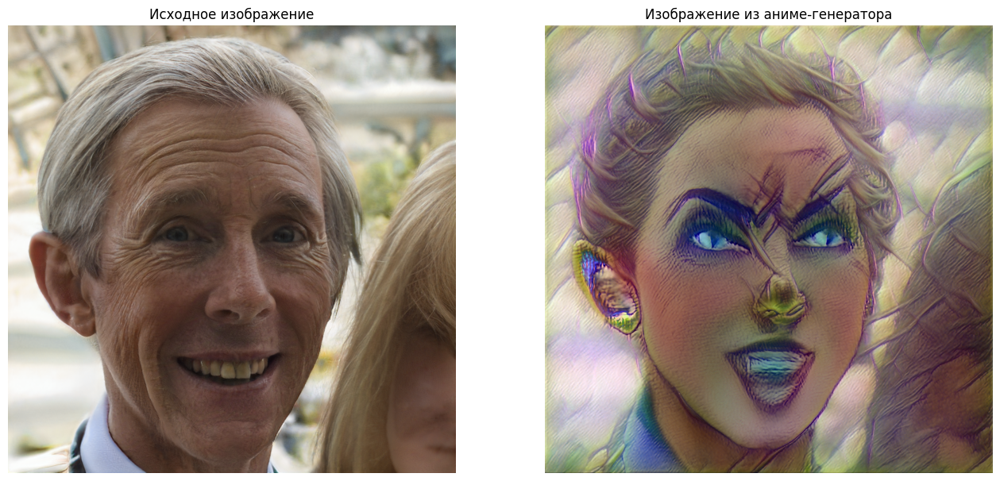

Step 800, Loss: 0.8594779968261719


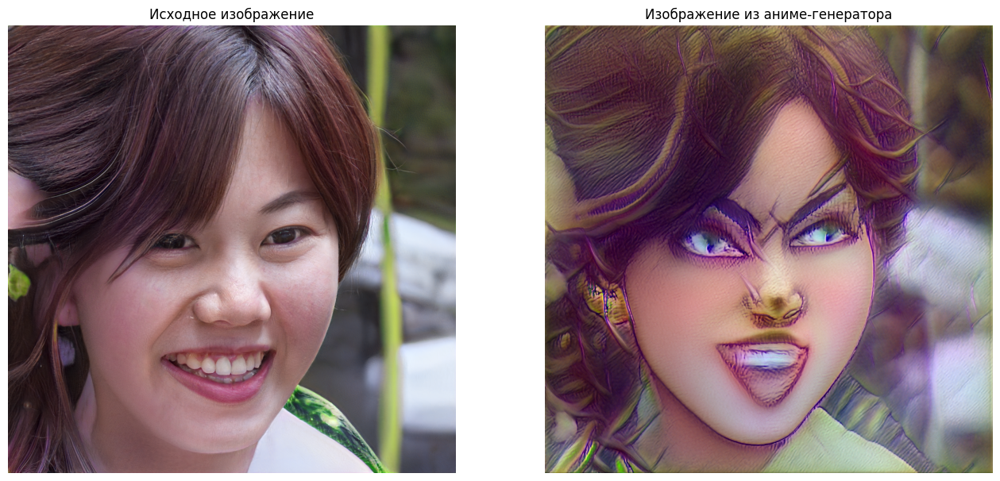

Step 850, Loss: 0.8799659609794617


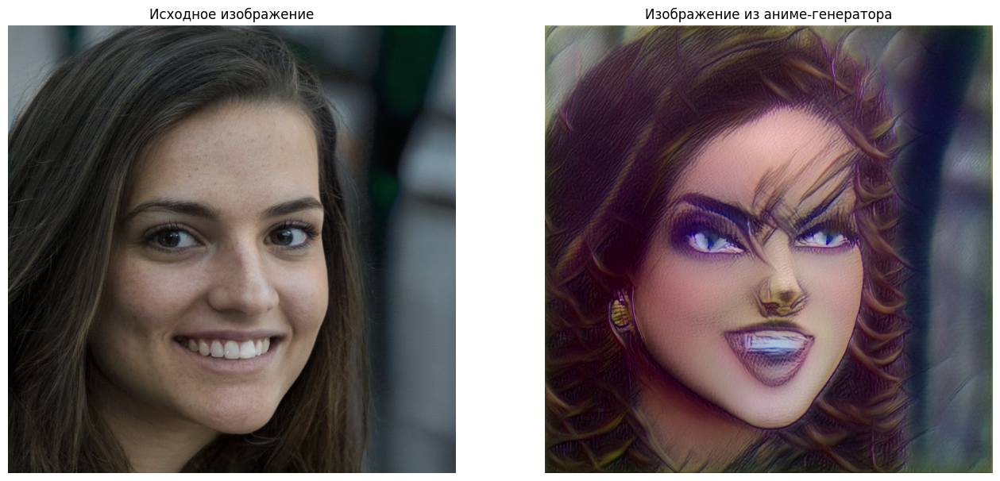

Step 900, Loss: 0.9607130289077759


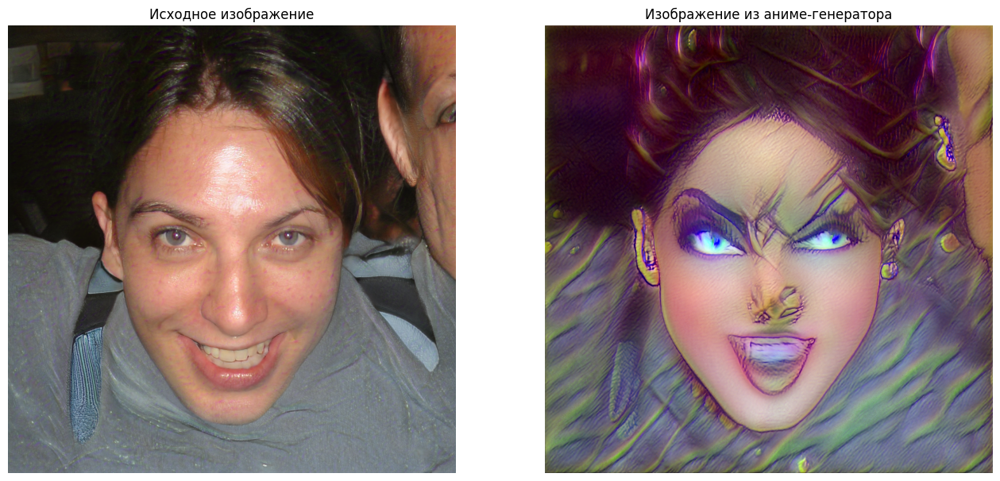

Step 950, Loss: 0.8535162210464478


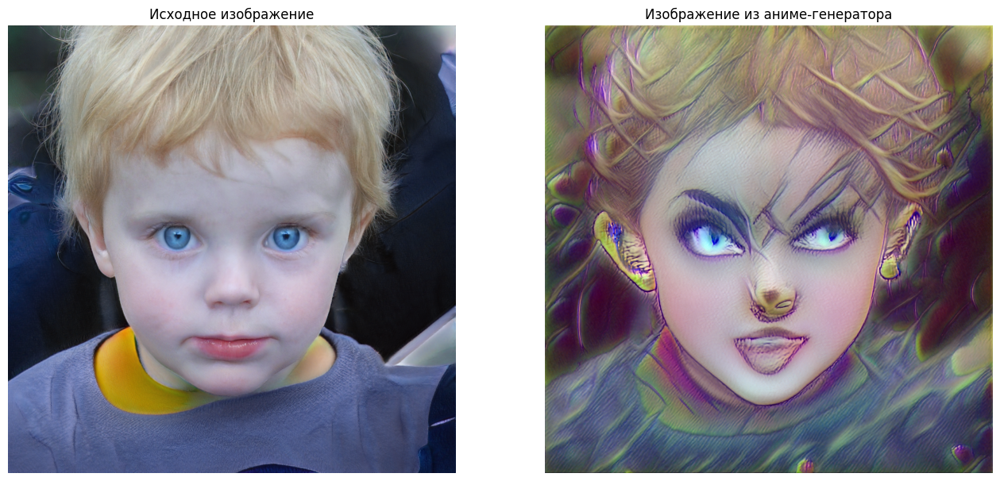

Step 1000, Loss: 0.9848795533180237


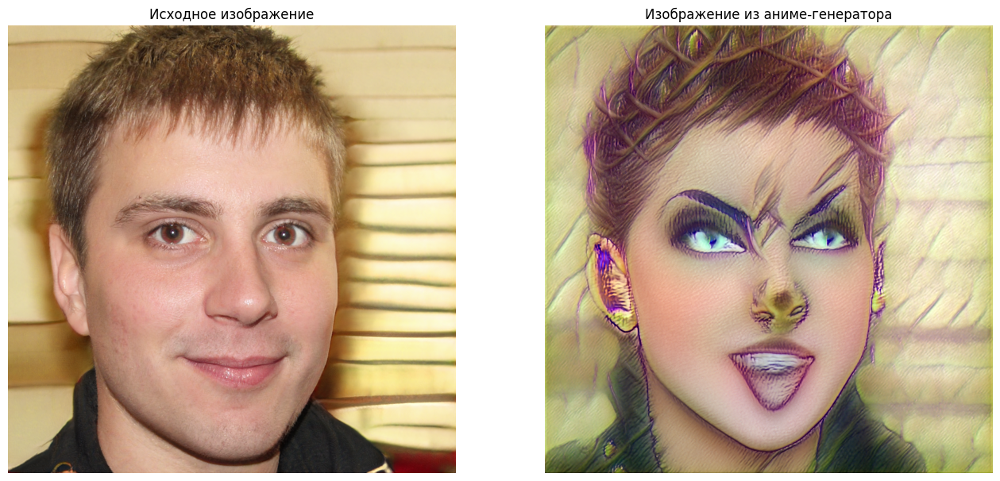

In [ ]:
torch.cuda.empty_cache()

# Инициализация
generator.train()
optimizer = torch.optim.Adam(generator.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.99)

num_steps = 1000
l2_lambda = 0.3
id_lambda = 0.6

losses = {'id': [], 'l2': [], 'clip': [], 'all': [], 'step': []}

for step in range(num_steps + 1):
    optimizer.zero_grad()
    
    # Генерация изображения
    z = torch.randn(1, 512).to(device)
    w = generator.get_latent(z)
    image, _ = generator([w], input_is_latent=True, randomize_noise=False)
    image_clean, _ = generator_clean([w], input_is_latent=True, randomize_noise=False)
    # Вычисление лоссов
    cur_clip_loss = clip_loss(image, source_text, target_text)
    cur_l2_loss = torch.nn.functional.mse_loss(image, image_clean)
    cur_id_loss = id_loss(image, image_clean)
    
    # Общий лосс
    loss = cur_clip_loss + l2_lambda * cur_l2_loss + id_lambda * cur_id_loss
    
    loss.backward()
    optimizer.step()
    scheduler.step()
    
    # Сохранение лоссов
    losses['clip'].append(cur_clip_loss.item())
    losses['l2'].append(cur_l2_loss.item())
    losses['id'].append(cur_id_loss.item())
    losses['all'].append(loss.item())
    losses['step'].append(step)

    if step % 100 == 0:
        print(f'Step {step}, Loss: {loss.item()}')
        visual_compare(image, image_clean)
    
    torch.cuda.empty_cache()  # Очистка памяти CUDA в конце итерации

Визуализируйте лоссы в зависимости от step

/tmp/ipykernel_35/2949480893.py:8: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na',True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use

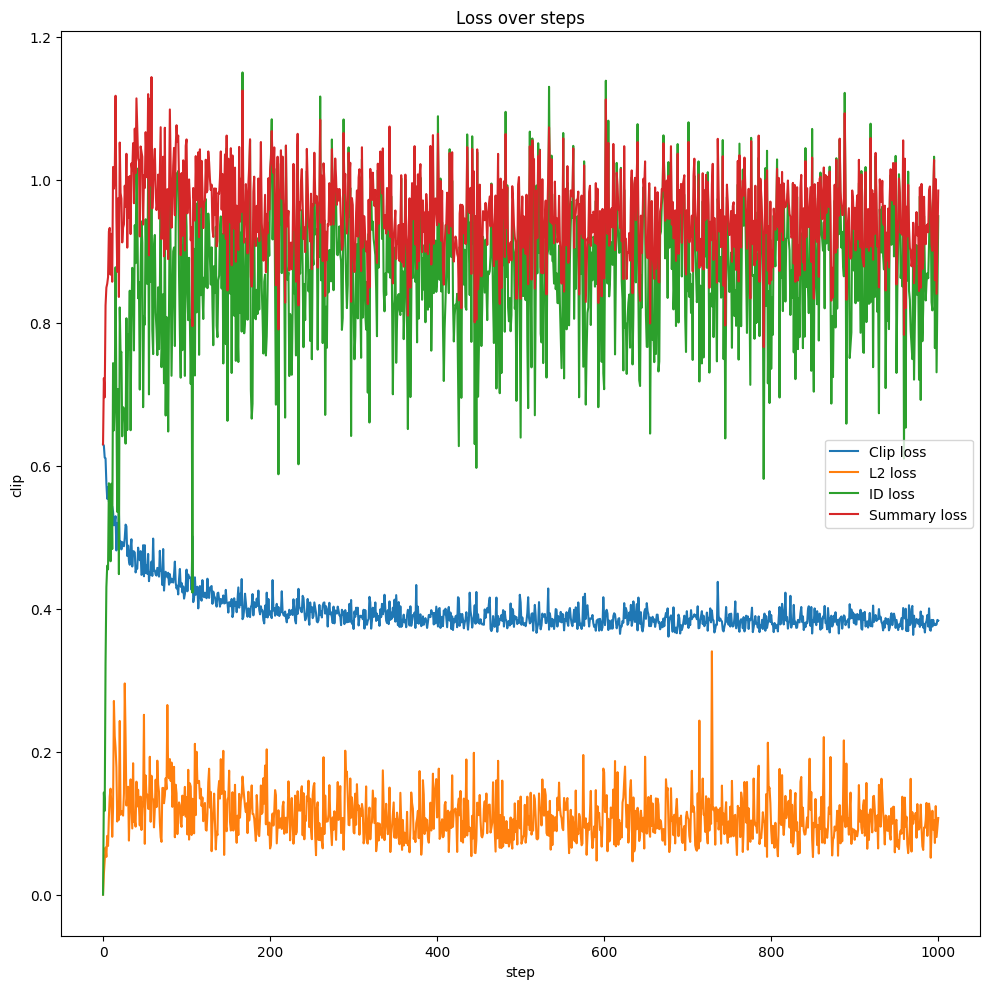

In [ ]:

import seaborn as sns
import pandas as pd

def display_metrics(losses):
    df = pd.DataFrame(losses)

    fig = plt.figure(figsize=(10, 10))
    with pd.option_context('mode.use_inf_as_na',True):
        sns.lineplot(data=df, x='step', y='clip',  label='Clip loss')
        sns.lineplot(data=df, x='step', y='l2',  label='L2 loss')
        sns.lineplot(data=df, x='step', y='id', label='ID loss')
        sns.lineplot(data=df, x='step', y='all', label='Summary loss')
    fig.axes[0].set_title('Loss over steps')
    plt.tight_layout()
    plt.show()


display_metrics(losses)

<h1>Редактирование реальных изображений</h1>

Теперь, мы бы хотели использовать обученный нами генератор для редактирования реальных изображений.

Введите в этот блок путь до изображения, которое хотите отредактировать

In [ ]:
from e4e_projection import project_image  # Или другой инвертор

source_file = f'picture.jpg' #@param {"type": "string"}
save_dir = f'./' #@param {"type": "string"}

real_image = project_image(source_file, generator) # представление изображения в w пространстве

edited_image, _ = generator([real_image], input_is_latent=True)

Давайте сравним отредактированное изображение с исходным

In [ ]:
visual_compare(edited_image, real_image)

Сохраним результаты!

In [ ]:
# Save the image to a .png file.
image_path = os.path.join(save_dir, "filtered.png")
save_image(image, image_path)


print(f"Ваше изображение успешно сохранено в папке {save_dir}")

Ваше изображение успешно сохранено в папке results


### Выводы

StyleGAN в синергии c CLIP позволяет относительно быстро обучать 